# Integrantes:
- André Vinicius Neves Alves - 202007040035

- Gabriel Silva Ribeiro - 202007040021

- Lyanh Vinicios Lopes Pinto - 202106840009

- Fernando Farias Dimas - 201906840031


### **Bibliotecas e Path**

In [ ]:
from google.colab import drive
import pandas as pd
import  numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.signal as sp
from scipy.signal import butter, filtfilt, ellip, windows
from  scipy.signal  import  windows
from scipy.fftpack import fft
from scipy.fft import fft
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
from scipy.stats import gaussian_kde
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import f1_score, recall_score, confusion_matrix
from sklearn.model_selection import LeaveOneOut
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import plot_tree
from numpy.fft import fft, fftfreq

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip '/content/drive/MyDrive/Trabalho PDS/DogMoveData_csv_format.zip'

Archive:  /content/drive/MyDrive/Trabalho PDS/DogMoveData_csv_format.zip
  inflating: DogMoveData.csv         


In [ ]:
file_path = '/content/DogMoveData.csv'
df = pd.read_csv(file_path)
print(df.head())

   DogID  TestNum  t_sec   ABack_x   ABack_y   ABack_z   ANeck_x   ANeck_y  \
0     16        1   0.00  0.041504  0.938965 -0.015137 -0.067871 -0.510254   
1     16        1   0.01  0.041992  0.941895 -0.020020 -0.128906 -0.494141   
2     16        1   0.02  0.040527  0.939453 -0.004395 -0.158691 -0.480469   
3     16        1   0.03  0.021484  0.946289  0.007813 -0.122070 -0.486816   
4     16        1   0.04 -0.000977  0.951172  0.033691 -0.053711 -0.500000   

    ANeck_z    GBack_x    GBack_y   GBack_z   GNeck_x   GNeck_y    GNeck_z  \
0 -0.934570 -17.639161 -22.766115  7.446290 -7.934571  6.347657  13.427735   
1 -0.913086 -15.075685 -11.413575  4.821778 -3.906250  4.394532  16.540528   
2 -0.911133 -12.207032  -0.122070  2.807617 -0.488281 -1.953125  26.794435   
3 -0.880371  -9.460450   7.995606  1.586914  1.159668 -5.676270  38.085940   
4 -0.807129  -8.361817  14.587403 -1.037598  4.577637  4.089356  41.503909   

          Task       Behavior_1   Behavior_2   Behavior_3   Po

Remover todas as colunas que contêm "Back" no nome

In [ ]:
df = df.loc[:, ~df.columns.str.contains('Back')]
print(df.head())

   DogID  TestNum  t_sec   ANeck_x   ANeck_y   ANeck_z   GNeck_x   GNeck_y  \
0     16        1   0.00 -0.067871 -0.510254 -0.934570 -7.934571  6.347657   
1     16        1   0.01 -0.128906 -0.494141 -0.913086 -3.906250  4.394532   
2     16        1   0.02 -0.158691 -0.480469 -0.911133 -0.488281 -1.953125   
3     16        1   0.03 -0.122070 -0.486816 -0.880371  1.159668 -5.676270   
4     16        1   0.04 -0.053711 -0.500000 -0.807129  4.577637  4.089356   

     GNeck_z         Task       Behavior_1   Behavior_2   Behavior_3  \
0  13.427735  <undefined>      <undefined>  <undefined>  <undefined>   
1  16.540528  <undefined>  Synchronization  <undefined>  <undefined>   
2  26.794435  <undefined>  Synchronization  <undefined>  <undefined>   
3  38.085940  <undefined>  Synchronization  <undefined>  <undefined>   
4  41.503909  <undefined>  Synchronization  <undefined>  <undefined>   

    PointEvent  
0  <undefined>  
1  <undefined>  
2  <undefined>  
3  <undefined>  
4  <undefined

### **Calculando as normas euclidianas**

In [ ]:
def calculate_norms(group):
    """Cacular as normas euclidianas"""
    group['Aneck_norm'] = np.sqrt(group['ANeck_x']**2 + group['ANeck_y']**2 + group['ANeck_z']**2)
    group['Gneck_norm'] = np.sqrt(group['GNeck_x']**2 + group['GNeck_y']**2 + group['GNeck_z']**2)
    return group

df_grouped = df.groupby('DogID').apply(calculate_norms)
print(df_grouped[['DogID', 'Aneck_norm', 'Gneck_norm']].head())

         DogID  Aneck_norm  Gneck_norm
DogID                                 
16    0     16    1.066952   16.839069
      1     16    1.046192   17.554480
      2     16    1.042208   26.869962
      3     16    1.013382   38.524066
      4     16    0.950969   41.955358


<ipython-input-6-c5d0f30fe940>:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_grouped = df.groupby('DogID').apply(calculate_norms)


In [ ]:
df_grouped

DogID  TestNum    t_sec   ANeck_x   ANeck_y   ANeck_z  \
DogID                                                                   
16    0            16        1     0.00 -0.067871 -0.510254 -0.934570   
      1            16        1     0.01 -0.128906 -0.494141 -0.913086   
      2            16        1     0.02 -0.158691 -0.480469 -0.911133   
      3            16        1     0.03 -0.122070 -0.486816 -0.880371   
      4            16        1     0.04 -0.053711 -0.500000 -0.807129   
...               ...      ...      ...       ...       ...       ...   
74    10611063     74        2  1928.19 -0.620605  0.326172 -0.647949   
      10611064     74        2  1928.20 -0.671875  0.241211 -0.660645   
      10611065     74        2  1928.21 -0.674805  0.244629 -0.627930   
      10611066     74        2  1928.22 -0.685059  0.211426 -0.578613   
      10611067     74        2  1928.23 -0.664063  0.254395 -0.527344   

                   GNeck_x     GNeck_y     GNeck_z               Task  \
DogID                                                                   
16    0          -7.934571    6.347657   13.427735        <undefined>   
      1          -3.906250    4.394532   16.540528        <undefined>   
      2          -0.488281   -1.953125   26.794435        <undefined>   
      3           1.159668   -5.676270   38.085940        <undefined>   
      4           4.577637    4.089356   41.503909        <undefined>   
...                    ...         ...         ...                ...   
74    10611063 -124.511726  107.727057 -122.497566  Task treat-search   
      10611064 -116.455085   97.534186 -123.229988  Task treat-search   
      10611065 -104.858405   95.458990 -124.816902  Task treat-search   
      10611066  -87.463384  101.257330 -128.601082  Task treat-search   
      10611067  -64.025883   93.688971 -128.906258  Task treat-search   

                     Behavior_1   Behavior_2   Behavior_3   PointEvent  \
DogID                                                                    
16    0             <undefined>  <undefined>  <undefined>  <undefined>   
      1         Synchronization  <undefined>  <undefined>  <undefined>   
      2         Synchronization  <undefined>  <undefined>  <undefined>   
      3         Synchronization  <undefined>  <undefined>  <undefined>   
      4         Synchronization  <undefined>  <undefined>  <undefined>   
...                         ...          ...          ...          ...   
74    10611063         Sniffing  <undefined>  <undefined>  <undefined>   
      10611064         Sniffing  <undefined>  <undefined>  <undefined>   
      10611065         Sniffing  <undefined>  <undefined>  <undefined>   
      10611066         Sniffing  <undefined>  <undefined>  <undefined>   
      10611067         Sniffing  <undefined>  <undefined>  <undefined>   

                Aneck_norm  Gneck_norm  
DogID                                   
16    0           1.066952   16.839069  
      1           1.046192   17.554480  
      2           1.042208   26.869962  
      3           1.013382   38.524066  
      4           0.950969   41.955358  
...                    ...         ...  
74    10611063    0.954660  205.216818  
      10611064    0.972651  195.602490  
      10611065    0.953678  188.909933  
      10611066    0.921303  185.583212  
      10611067    0.885318  171.737475  

[10611068 rows x 16 columns]

### **Distribuição do Acelerômetro**

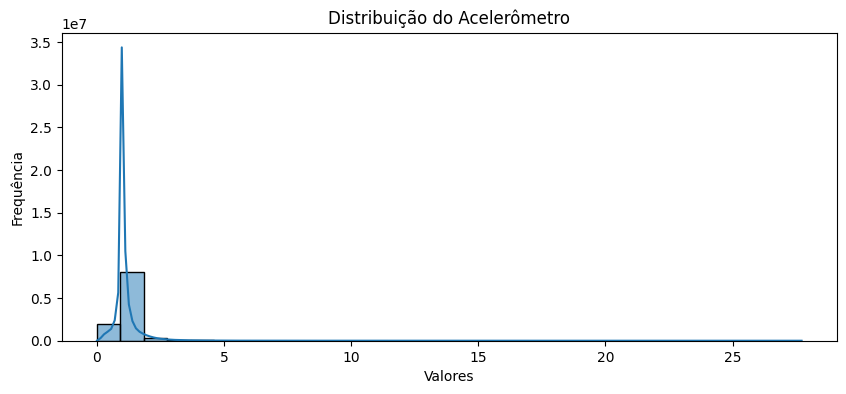

In [ ]:
# Plot da distribuição normal dos valores da coluna
plt.figure(figsize=(10, 4))
sns.histplot(df_grouped['Aneck_norm'], kde=True, bins=30)
plt.title('Distribuição do Acelerômetro')
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.show()

### **Distribuição do Giroscópio**

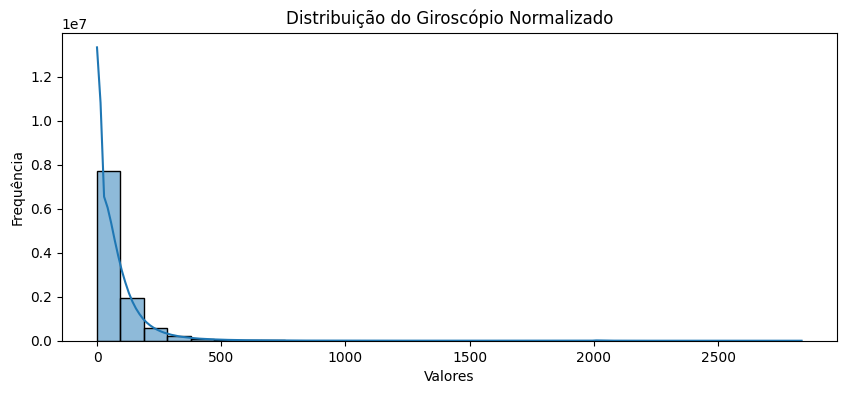

In [ ]:
# Plot da distribuição normal dos valores da coluna
plt.figure(figsize=(10, 4))
sns.histplot(df_grouped['Gneck_norm'], kde=True, bins=30)
plt.title('Distribuição do Giroscópio Normalizado')
plt.xlabel('Valores')
plt.ylabel('Frequência')
plt.show()

### **Giroscópio e Acelerômetro**
Visualizar os sinais do giroscópio e do acelerômetro de um cachorro específico, facilitando a análise do comportamento e movimento do animal ao longo do tempo.

In [ ]:
dog_id_to_plot = 60

# Verificar se o DataFrame df_grouped existe
if 'df_grouped' in globals():
    if dog_id_to_plot in df_grouped.index.get_level_values('DogID'):
        # Filtrar os dados do DogID
        df_dog = df_grouped.loc[dog_id_to_plot]
        gyr_x = df_dog['GNeck_x'].values
        gyr_y = df_dog['GNeck_y'].values
        gyr_z = df_dog['GNeck_z'].values
        acc_x = df_dog['ANeck_x'].values
        acc_y = df_dog['ANeck_y'].values
        acc_z = df_dog['ANeck_z'].values
        tempo = df_dog['t_sec'].values

        # Gráfico do Giroscópio
        fig_gyr = go.Figure()
        fig_gyr.add_trace(go.Scatter(x=tempo, y=gyr_x, mode='lines', name='Giroscópio X', line=dict(color='cornflowerblue')))
        fig_gyr.add_trace(go.Scatter(x=tempo, y=gyr_y, mode='lines', name='Giroscópio Y', line=dict(color='goldenrod')))
        fig_gyr.add_trace(go.Scatter(x=tempo, y=gyr_z, mode='lines', name='Giroscópio Z', line=dict(color='green')))
        fig_gyr.update_layout(
            title=f'Sinal do Giroscópio para o Cachorro {dog_id_to_plot}',
            xaxis_title='Tempo (s)',
            yaxis_title='Amplitude (Giroscópio)',
            height=400,
            width=1200
        )
        fig_gyr.show()

        # Gráfico do Acelerômetro
        fig_acc = go.Figure()
        fig_acc.add_trace(go.Scatter(x=tempo, y=acc_x, mode='lines', name='Acelerômetro X', line=dict(color='cornflowerblue')))
        fig_acc.add_trace(go.Scatter(x=tempo, y=acc_y, mode='lines', name='Acelerômetro Y', line=dict(color='goldenrod')))
        fig_acc.add_trace(go.Scatter(x=tempo, y=acc_z, mode='lines', name='Acelerômetro Z', line=dict(color='green')))
        fig_acc.update_layout(
            title=f'Sinal do Acelerômetro para o Cachorro {dog_id_to_plot}',
            xaxis_title='Tempo (s)',
            yaxis_title='Amplitude (Acelerômetro)',
            height=400,
            width=1200
        )
        fig_acc.show()

    else:
        print(f"Nenhum dado encontrado para DogID {dog_id_to_plot}.")

### **FFT para Acelerômetro e Giroscópio**
Transformada Rápida de Fourier para sinais de acelerômetro e giroscópio de um cachorro específico, permitindo a análise da frequência e amplitude dos sinais.

In [ ]:
def calculate_fft(sinal):
    """Função para calcular o FFT e preparar os dados"""
    n = len(sinal)
    ft = fft(sinal) / 100
    timestep = 0.01
    frequencias = fftfreq(n, d=timestep)

    # Filtrar para a metade positiva do espectro
    frequencias = frequencias[:n // 2]
    ft_amplitude = np.abs(ft)[:n // 2]

    return frequencias, ft_amplitude

dog_id_to_analyze = 60
df_dog = df_grouped.loc[dog_id_to_analyze]

# Extrair os sinais normalizados
acc_norm = df_dog['Aneck_norm'].values
gyr_norm = df_dog['Gneck_norm'].values

# Calcular o FFT para os sinais
freq_acc, amp_acc = calculate_fft(acc_norm)
freq_gyr, amp_gyr = calculate_fft(gyr_norm)

fig = make_subplots(rows=1, cols=2, subplot_titles=(
    f"Espectro de Amplitude - Acelerômetro para o DogID {dog_id_to_analyze}",
    f"Espectro de Amplitude - Giroscópio para o DogID {dog_id_to_analyze}"
))

fig.add_trace(go.Scatter(x=freq_acc, y=amp_acc, mode='lines', name="Acelerômetro"), row=1, col=1)
fig.add_trace(go.Scatter(x=freq_gyr, y=amp_gyr, mode='lines', name="Giroscópio"), row=1, col=2)

fig.update_layout(
    width=1600,
    height=500,
    title_text="Espectro de Amplitude - FFT dos Sinais Normalizados"
)

fig.update_xaxes(title_text="Frequência (Hz)", row=1, col=1)
fig.update_yaxes(title_text="Amplitude", row=1, col=1)
fig.update_xaxes(title_text="Frequência (Hz)", row=1, col=2)
fig.update_yaxes(title_text="Amplitude", row=1, col=2)
fig.show()

### **Criando os filtros**
Filtro elíptico passa-alta e um filtro Butterworth passa-baixa e, em seguida, exibe suas características por meio de gráficos interativos com plotly. Inclui a resposta em frequência e o diagrama de polos e zeros de ambos os filtros.

In [ ]:
def create_ellip_highpass(fp, fs, fss, gp, gs):
    """Função para criar filtro elíptico passa-alta"""
    fn = fss / 2  # Frequência de Nyquist
    b, a = sp.iirdesign(wp=fp / fn, ws=fs / fn, gpass=gp, gstop=gs, analog=False, ftype='ellip', output='ba')
    return b, a

def create_butter_lowpass(passband_freq, fs, order):
    """Função para criar filtro Butterworth passa-baixa"""
    nyq = 0.5 * fs
    normal_cutoff = passband_freq / nyq
    b, a = sp.butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

# Parâmetros do filtro
passband_freq_ellip = 3
stopband_freq_ellip = 0.5
fs = 100
passband_gain_ellip = 1
stopband_atten_ellip = 50

# Parâmetros do filtro Butterworth
passband_freq_butter = 10
order_butter = 5

b_high, a_high = create_ellip_highpass(passband_freq_ellip, stopband_freq_ellip, fs, passband_gain_ellip, stopband_atten_ellip)
b_low, a_low = create_butter_lowpass(passband_freq_butter, fs, order_butter)

fig = make_subplots(rows=2, cols=2, subplot_titles=("Elíptico Passa-Alta - Resposta em Frequência",
                                                   "Elíptico Passa-Alta - Diagrama de Polos e Zeros",
                                                   "Butterworth Passa-Baixa - Resposta em Frequência",
                                                   "Butterworth Passa-Baixa - Diagrama de Polos e Zeros"),
                    column_widths=[0.7, 0.3])
# Resposta em frequência do filtro elíptico passa-alta
w_high, h_high = sp.freqz(b_high, a_high, fs=fs)
fig.add_trace(
    go.Scatter(x=w_high, y=20 * np.log10(np.abs(h_high)), mode='lines', name='Magnitude', line=dict(color='brown')),
    row=1, col=1
)
# Diagrama de polos e zeros do filtro elíptico passa-alta
z_high, p_high, k_high = sp.tf2zpk(b_high, a_high)
fig.add_trace(go.Scatter(x=np.real(z_high), y=np.imag(z_high), mode='markers', marker=dict(color='green', symbol='circle', size=10), name='Zeros'), row=1, col=2)
fig.add_trace(go.Scatter(x=np.real(p_high), y=np.imag(p_high), mode='markers', marker=dict(color='red', symbol='x', size=10), name='Polos'), row=1, col=2)
fig.add_trace(go.Scatter(x=np.cos(np.linspace(0, 2 * np.pi, 100)), y=np.sin(np.linspace(0, 2 * np.pi, 100)),
                         mode='lines', line=dict(color='blue', dash='dash'), name='Círculo Unitário', showlegend=False), row=1, col=2)
# Resposta em frequência do filtro Butterworth passa-baixa
w_low, h_low = sp.freqz(b_low, a_low, fs=fs)
fig.add_trace(
    go.Scatter(x=w_low, y=20 * np.log10(np.abs(h_low)), mode='lines', name='Magnitude', line=dict(color='purple')),
    row=2, col=1
)
# Diagrama de polos e zeros do filtro Butterworth passa-baixa
z_low, p_low, k_low = sp.tf2zpk(b_low, a_low)
fig.add_trace(go.Scatter(x=np.real(z_low), y=np.imag(z_low), mode='markers', marker=dict(color='green', symbol='circle', size=10), showlegend=False), row=2, col=2)
fig.add_trace(go.Scatter(x=np.real(p_low), y=np.imag(p_low), mode='markers', marker=dict(color='red', symbol='x', size=10), showlegend=False), row=2, col=2)
fig.add_trace(go.Scatter(x=np.cos(np.linspace(0, 2 * np.pi, 100)), y=np.sin(np.linspace(0, 2 * np.pi, 100)),
                         mode='lines', line=dict(color='blue', dash='dash'), showlegend=False), row=2, col=2)
fig.update_layout(
    title_text="Análise de Filtros: Resposta em Frequência e Diagrama de Polos e Zeros",
    height=800,
    width=1500
)
fig.update_xaxes(title_text="Frequência [Hz]", row=1, col=1, range=[0, 50])
fig.update_yaxes(title_text="Magnitude [dB]", row=1, col=1, range=[-100, 3])
fig.update_xaxes(title_text="Parte Real", row=1, col=2, range=[-1.5, 1.5])
fig.update_yaxes(title_text="Parte Imaginária", row=1, col=2, range=[-1.5, 1.5])
fig.update_xaxes(title_text="Frequência [Hz]", row=2, col=1, range=[0, 50])
fig.update_yaxes(title_text="Magnitude [dB]", row=2, col=1, range=[-100, 3])
fig.update_xaxes(title_text="Parte Real", row=2, col=2, range=[-1.5, 1.5])
fig.update_yaxes(title_text="Parte Imaginária", row=2, col=2, range=[-1.5, 1.5])
fig.show()

### **Aplicação dos filtros**
Aplica um filtro elíptico passa-alta e um filtro Butterworth passa-baixa aos sinais de um conjunto de dados agrupados por `DogID`, salvando os resultados filtrados em um dicionário `filtered_results` e atualizando o `DataFrame` original com esses sinais filtrados.

In [ ]:
filtered_results = {} # Dicionário global para armazenar os resultados dos filtros para cada DogID

def apply_filters_to_signals(df, dog_id, b_high, a_high, b_low, a_low):
    """
    Aplica o filtro elíptico passa-alta e o Butterworth passa-baixa aos sinais correspondentes ao DogID.

    Parameters:
    ----------
    df : DataFrame
        O DataFrame que contém os sinais, incluindo colunas 'Aneck_norm', 'Gneck_norm', e 'DogID'.
    dog_id : int
        O DogID que deseja filtrar.
    b_high, a_high : numpy arrays
        Coeficientes do filtro elíptico passa-alta.
    b_low, a_low : numpy arrays
        Coeficientes do filtro Butterworth passa-baixa.

    Returns:
    --------
    an_high_filtered, gn_high_filtered, an_filtered, gn_filtered : numpy arrays
        Sinais 'Aneck_norm' e 'Gneck_norm' filtrados.
    """
    df_dog = df[df['DogID'] == dog_id]
    an_norm = np.array(df_dog['Aneck_norm'])
    gn_norm = np.array(df_dog['Gneck_norm'])

    # Aplicar o filtro elíptico passa-alta
    an_high_filtered = sp.filtfilt(b_high, a_high, an_norm)
    gn_high_filtered = sp.filtfilt(b_high, a_high, gn_norm)

    # Aplicar o filtro Butterworth passa-baixa
    an_filtered = sp.filtfilt(b_low, a_low, an_high_filtered)
    gn_filtered = sp.filtfilt(b_low, a_low, gn_high_filtered)

    return an_high_filtered, gn_high_filtered, an_filtered, gn_filtered

def apply_filters_to_all_dogs(df, b_high, a_high, b_low, a_low, dog_id_to_plot):
    """
    Aplica os filtros elíptico passa-alta e Butterworth passa-baixa para todos os DogIDs,
    salva os sinais filtrados no DataFrame e exibe o gráfico de um DogID.

    Parameters:
    ----------
    df : DataFrame
        O DataFrame que contém os sinais.
    b_high, a_high : numpy arrays
        Coeficientes do filtro elíptico passa-alta.
    b_low, a_low : numpy arrays
        Coeficientes do filtro Butterworth passa-baixa.
    dog_id_to_plot : int
        O DogID que será exibido no gráfico como exemplo.
    """
    global filtered_results
    dog_ids = df['DogID'].unique()

    for dog_id in dog_ids:
        an_high_f, gn_high_f, an_filtered, gn_filtered = apply_filters_to_signals(df, dog_id, b_high, a_high, b_low, a_low)
        # Armazenar os resultados dos filtros no dicionário global
        filtered_results[dog_id] = {
            'Aneck_norm_high_filtered': an_high_f,
            'Gneck_norm_high_filtered': gn_high_f,
            'Aneck_norm_filtered': an_filtered,
            'Gneck_norm_filtered': gn_filtered
        }
        # Adicionar os sinais filtrados ao DataFrame principal
        df.loc[df['DogID'] == dog_id, 'Aneck_norm_filtered'] = an_filtered
        df.loc[df['DogID'] == dog_id, 'Gneck_norm_filtered'] = gn_filtered

    an_filtered_example = df[df['DogID'] == dog_id_to_plot]['Aneck_norm_filtered'].values
    gn_filtered_example = df[df['DogID'] == dog_id_to_plot]['Gneck_norm_filtered'].values

    # Criar o gráfico para o sinal 'Aneck_norm' filtrado
    fig_an = go.Figure()
    fig_an.add_trace(go.Scatter(
        y=an_filtered_example,
        mode='lines',
        line=dict(color='blue'),
        name='Aneck_norm Filtrado'
    ))
    fig_an.update_layout(
        title=f'Sinal Aneck_norm Filtrado para DogID {dog_id_to_plot}',
        xaxis_title='Amostra',
        yaxis_title='Amplitude',
        width=1200,
        height=400
    )
    fig_an.show()

    # Criar o gráfico para o sinal 'Gneck_norm' filtrado
    fig_gn = go.Figure()
    fig_gn.add_trace(go.Scatter(
        y=gn_filtered_example,
        mode='lines',
        line=dict(color='green'),
        name='Gneck_norm Filtrado'
    ))
    fig_gn.update_layout(
        title=f'Sinal Gneck_norm Filtrado para DogID {dog_id_to_plot}',
        xaxis_title='Amostra',
        yaxis_title='Amplitude',
        width=1200,
        height=400
    )
    fig_gn.show()

# Exemplo de uso
dog_id_to_plot = 60
apply_filters_to_all_dogs(df_grouped, b_high, a_high, b_low, a_low, dog_id_to_plot)

In [ ]:
df_grouped

DogID  TestNum    t_sec   ANeck_x   ANeck_y   ANeck_z  \
DogID                                                                   
16    0            16        1     0.00 -0.067871 -0.510254 -0.934570   
      1            16        1     0.01 -0.128906 -0.494141 -0.913086   
      2            16        1     0.02 -0.158691 -0.480469 -0.911133   
      3            16        1     0.03 -0.122070 -0.486816 -0.880371   
      4            16        1     0.04 -0.053711 -0.500000 -0.807129   
...               ...      ...      ...       ...       ...       ...   
74    10611063     74        2  1928.19 -0.620605  0.326172 -0.647949   
      10611064     74        2  1928.20 -0.671875  0.241211 -0.660645   
      10611065     74        2  1928.21 -0.674805  0.244629 -0.627930   
      10611066     74        2  1928.22 -0.685059  0.211426 -0.578613   
      10611067     74        2  1928.23 -0.664063  0.254395 -0.527344   

                   GNeck_x     GNeck_y     GNeck_z               Task  \
DogID                                                                   
16    0          -7.934571    6.347657   13.427735        <undefined>   
      1          -3.906250    4.394532   16.540528        <undefined>   
      2          -0.488281   -1.953125   26.794435        <undefined>   
      3           1.159668   -5.676270   38.085940        <undefined>   
      4           4.577637    4.089356   41.503909        <undefined>   
...                    ...         ...         ...                ...   
74    10611063 -124.511726  107.727057 -122.497566  Task treat-search   
      10611064 -116.455085   97.534186 -123.229988  Task treat-search   
      10611065 -104.858405   95.458990 -124.816902  Task treat-search   
      10611066  -87.463384  101.257330 -128.601082  Task treat-search   
      10611067  -64.025883   93.688971 -128.906258  Task treat-search   

                     Behavior_1   Behavior_2   Behavior_3   PointEvent  \
DogID                                                                    
16    0             <undefined>  <undefined>  <undefined>  <undefined>   
      1         Synchronization  <undefined>  <undefined>  <undefined>   
      2         Synchronization  <undefined>  <undefined>  <undefined>   
      3         Synchronization  <undefined>  <undefined>  <undefined>   
      4         Synchronization  <undefined>  <undefined>  <undefined>   
...                         ...          ...          ...          ...   
74    10611063         Sniffing  <undefined>  <undefined>  <undefined>   
      10611064         Sniffing  <undefined>  <undefined>  <undefined>   
      10611065         Sniffing  <undefined>  <undefined>  <undefined>   
      10611066         Sniffing  <undefined>  <undefined>  <undefined>   
      10611067         Sniffing  <undefined>  <undefined>  <undefined>   

                Aneck_norm  Gneck_norm  Aneck_norm_filtered  \
DogID                                                         
16    0           1.066952   16.839069            -0.007884   
      1           1.046192   17.554480            -0.049064   
      2           1.042208   26.869962            -0.083975   
      3           1.013382   38.524066            -0.106707   
      4           0.950969   41.955358            -0.112480   
...                    ...         ...                  ...   
74    10611063    0.954660  205.216818            -0.096435   
      10611064    0.972651  195.602490            -0.084321   
      10611065    0.953678  188.909933            -0.081089   
      10611066    0.921303  185.583212            -0.087669   
      10611067    0.885318  171.737475            -0.100199   

                Gneck_norm_filtered  
DogID                                
16    0                    0.757716  
      1                    5.123704  
      2                    9.120529  
      3                   12.409233  
      4                   14.748737  
...                             ...  
74    10611063            28.

### **FFT do Acelerômetro e Giroscópio**
Calcula a Transformada Rápida de Fourier (FFT) dos sinais filtrados de um acelerômetro e de um giroscópio para um `DogID` específico.

In [ ]:
def calculate_fft(signal, fs):
    """Função para calcular a FFT e retornar a frequência e a magnitude"""
    N = len(signal)
    freq = np.fft.fftfreq(N, d=1/fs)
    fft_values = np.fft.fft(signal)
    fft_magnitude = np.abs(fft_values)
    return freq[:N // 2], fft_magnitude[:N // 2]

dog_id_to_plot = 60
df_dog_filtered = df_grouped[df_grouped['DogID'] == dog_id_to_plot]
aneck_filtered = np.array(df_dog_filtered['Aneck_norm_filtered'])
gneck_filtered = np.array(df_dog_filtered['Gneck_norm_filtered'])

fs = 100 # frequência de amostragem

freq_aneck, fft_aneck = calculate_fft(aneck_filtered, fs)
freq_gneck, fft_gneck = calculate_fft(gneck_filtered, fs)

fig_aneck = go.Figure()
fig_aneck.add_trace(go.Scatter(
    x=freq_aneck,
    y=fft_aneck,
    mode='lines',
    line=dict(color='blue'),
    name='Aneck_norm Filtrado'
))
fig_aneck.update_layout(
    title='Espectro de Frequência - Aneck_norm Filtrado',
    xaxis_title='Frequência (Hz)',
    yaxis_title='Magnitude',
    width=1200,
    height=400
)
fig_aneck.show()

fig_gneck = go.Figure()
fig_gneck.add_trace(go.Scatter(
    x=freq_gneck,
    y=fft_gneck,
    mode='lines',
    line=dict(color='green'),
    name='Gneck_norm Filtrado'
))
fig_gneck.update_layout(
    title='Espectro de Frequência - Gneck_norm Filtrado',
    xaxis_title='Frequência (Hz)',
    yaxis_title='Magnitude',
    width=1200,
    height=400
)
fig_gneck.show()

### **Janelamento**
Função de janela deslizante (sliding window) que permite dividir um sinal em seções menores de um tamanho especificado.

In [ ]:
def sliding_window(signal, window_size:int, step_size:int):
    """
    Implementa uma janela de observação deslizante ao longo de um sinal.

    Parameters:
    ----------
    signal: np.array- ou list-like
        Sinal de entrada; pode ser uma lista ou um array numpy.

    window_size: int
        Tamanho da janela de observação, dado em elementos do sinal de entrada.

    step_size: int
        Valor do deslocamento da janela de observada, em elementos do sinal de
        entrada.
    """

    for i in range(0, len(signal) - window_size + 1, step_size):
        yield signal[i:i+window_size]

### **Janela de Hann**
Aplica uma janela de Hann sobre sinais filtrados usando uma abordagem de janela deslizante.


In [ ]:
def apply_hann_window_with_sliding(signal, window_size, step_size):
    """
    Aplica o janelamento de Hann com uma janela deslizante.

    Parameters:
    ----------
    signal : numpy array
        O sinal a ser janelado.
    window_size : int
        Tamanho da janela.
    step_size : int
        Passo da janela para sobreposição.

    Returns:
    --------
    windows : list of numpy arrays
        Lista contendo as janelas do sinal multiplicadas pela janela de Hann.
    """
    hann_window = np.hanning(window_size)
    windows = []
    # Aplicar a janela de Hann sobre cada segmento deslizante
    for i in range(0, len(signal) - window_size + 1, step_size):
        window = signal[i:i+window_size] * hann_window
        windows.append(window)
    return windows

def process_and_plot_filtered_windowed_signals(df, window_size, step_size, dog_id_to_plot):
    """
    Aplica o janelamento de Hann nos sinais já filtrados e plota os resultados para um DogID específico.

    Parameters:
    ----------
    df : DataFrame
        O DataFrame que contém os sinais já filtrados.
    window_size : int
        Tamanho da janela para o janelamento.
    step_size : int
        Passo para o deslizamento da janela.
    dog_id_to_plot : int
        O DogID que será exibido no gráfico como exemplo.
    """
    df_dog = df[df['DogID'] == dog_id_to_plot]
    if df_dog.empty:
        print(f"Nenhum dado encontrado para DogID {dog_id_to_plot}.")
        return

    # Obter os sinais já filtrados
    an_filtered = np.array(df_dog['Aneck_norm_filtered'])
    gn_filtered = np.array(df_dog['Gneck_norm_filtered'])

    # Aplicar janelamento de Hann nos sinais filtrados
    an_windows = apply_hann_window_with_sliding(an_filtered, window_size, step_size)
    gn_windows = apply_hann_window_with_sliding(gn_filtered, window_size, step_size)

    # Criar gráfico para a primeira janela do sinal Aneck_norm_filtered
    fig_an = go.Figure()
    fig_an.add_trace(go.Scatter(
        y=an_windows[0],
        mode='lines',
        name='Aneck_norm_filtered - Primeira Janela com Hann',
        line=dict(color='blue')
    ))
    fig_an.update_layout(
        title=f'Primeira Janela do Sinal Acelerômetro Normalizado Filtrado e Janelado com Hann para DogID {dog_id_to_plot}',
        xaxis_title='Amostra',
        yaxis_title='Amplitude',
        height=400,
        width=1000
    )
    fig_an.show()

    # Criar gráfico para a primeira janela do sinal Gneck_norm_filtered
    fig_gn = go.Figure()
    fig_gn.add_trace(go.Scatter(
        y=gn_windows[0],
        mode='lines',
        name='Gneck_norm_filtered - Primeira Janela com Hann',
        line=dict(color='green')
    ))
    fig_gn.update_layout(
        title=f'Primeira Janela do Sinal Giroscópio Normalizado, Filtrado e Janelado com Hann para DogID {dog_id_to_plot}',
        xaxis_title='Amostra',
        yaxis_title='Amplitude',
        height=400,
        width=1000
    )
    fig_gn.show()

# Exemplo de uso
window_size = 200
step_size = 100
dog_id_to_plot = 18
process_and_plot_filtered_windowed_signals(df_grouped, window_size, step_size, dog_id_to_plot)

### **Concatenar 3 Colunas Behavior**
Cria uma nova coluna chamada `Behavior` no DataFrame `df_grouped`, que combina informações de três colunas existentes (`Behavior_1`, `Behavior_2` e `Behavior_3`).

In [ ]:
df_grouped['Behavior'] = df_grouped['Behavior_1'] + '-' + df_grouped['Behavior_2'] + '-' + df_grouped['Behavior_3']
df_grouped

DogID  TestNum    t_sec   ANeck_x   ANeck_y   ANeck_z  \
DogID                                                                   
16    0            16        1     0.00 -0.067871 -0.510254 -0.934570   
      1            16        1     0.01 -0.128906 -0.494141 -0.913086   
      2            16        1     0.02 -0.158691 -0.480469 -0.911133   
      3            16        1     0.03 -0.122070 -0.486816 -0.880371   
      4            16        1     0.04 -0.053711 -0.500000 -0.807129   
...               ...      ...      ...       ...       ...       ...   
74    10611063     74        2  1928.19 -0.620605  0.326172 -0.647949   
      10611064     74        2  1928.20 -0.671875  0.241211 -0.660645   
      10611065     74        2  1928.21 -0.674805  0.244629 -0.627930   
      10611066     74        2  1928.22 -0.685059  0.211426 -0.578613   
      10611067     74        2  1928.23 -0.664063  0.254395 -0.527344   

                   GNeck_x     GNeck_y     GNeck_z               Task  \
DogID                                                                   
16    0          -7.934571    6.347657   13.427735        <undefined>   
      1          -3.906250    4.394532   16.540528        <undefined>   
      2          -0.488281   -1.953125   26.794435        <undefined>   
      3           1.159668   -5.676270   38.085940        <undefined>   
      4           4.577637    4.089356   41.503909        <undefined>   
...                    ...         ...         ...                ...   
74    10611063 -124.511726  107.727057 -122.497566  Task treat-search   
      10611064 -116.455085   97.534186 -123.229988  Task treat-search   
      10611065 -104.858405   95.458990 -124.816902  Task treat-search   
      10611066  -87.463384  101.257330 -128.601082  Task treat-search   
      10611067  -64.025883   93.688971 -128.906258  Task treat-search   

                     Behavior_1   Behavior_2   Behavior_3   PointEvent  \
DogID                                                                    
16    0             <undefined>  <undefined>  <undefined>  <undefined>   
      1         Synchronization  <undefined>  <undefined>  <undefined>   
      2         Synchronization  <undefined>  <undefined>  <undefined>   
      3         Synchronization  <undefined>  <undefined>  <undefined>   
      4         Synchronization  <undefined>  <undefined>  <undefined>   
...                         ...          ...          ...          ...   
74    10611063         Sniffing  <undefined>  <undefined>  <undefined>   
      10611064         Sniffing  <undefined>  <undefined>  <undefined>   
      10611065         Sniffing  <undefined>  <undefined>  <undefined>   
      10611066         Sniffing  <undefined>  <undefined>  <undefined>   
      10611067         Sniffing  <undefined>  <undefined>  <undefined>   

                Aneck_norm  Gneck_norm  Aneck_norm_filtered  \
DogID                                                         
16    0           1.066952   16.839069            -0.007884   
      1           1.046192   17.554480            -0.049064   
      2           1.042208   26.869962            -0.083975   
      3           1.013382   38.524066            -0.106707   
      4           0.950969   41.955358            -0.112480   
...                    ...         ...                  ...   
74    10611063    0.954660  205.216818            -0.096435   
      10611064    0.972651  195.602490            -0.084321   
      10611065    0.953678  188.909933            -0.081089   
      10611066    0.921303  185.583212            -0.087669   
      10611067    0.885318  171.737475            -0.100199   

                Gneck_norm_filtered                                 Behavior  
DogID                                                                         
16    0                    0.757716      <undefined>-<undefined>-<undefined>  
      1                    5.123704  Synchronization-<undefined>-<undefined>  
      2          

### **Identificar e Atribuir Comportamento**
Define funções para identificar e atribuir o comportamento predominante a janelas deslizantes de dados comportamentais dentro de um DataFrame, onde cada janela contém informações sobre os comportamentos de um determinado `DogID`.

In [ ]:
def predominant_behavior(window_behaviors):
    """
    Verifica qual comportamento predomina em 75% da janela.

    Parameters:
    ----------
    window_behaviors : list or pandas Series
        Lista de comportamentos dentro de uma janela.
    """
    behavior_counts = window_behaviors.value_counts(normalize=True)
    for behavior, freq in behavior_counts.items():
        if freq >= 0.75:
            clean_behavior = '-'.join([part for part in behavior.split('-') if '<undefined>' not in part])
            return clean_behavior
    return 'undefined'


def assign_behavior_to_existing_windows(df, window_size, step_size):
    """
    Atribui o comportamento predominante em cada janela deslizante já existente (nas normas).

    Parameters:
    ----------
    df : DataFrame
        O DataFrame que contém os sinais e os comportamentos.
    window_size : int
        Tamanho da janela que foi usada no janelamento anterior.
    step_size : int
        Passo para o deslizamento da janela.
    """
    predominant_behaviors_per_window = []

    # Aplicar o janelamento em 'Behavior' para cada DogID
    for dog_id in df['DogID'].unique():
        df_dog = df[df['DogID'] == dog_id]
        if df_dog.empty:
            print(f"Nenhum dado encontrado para DogID {dog_id}.")
            continue
        behavior_series = df_dog['Behavior']

        for i in range(0, len(behavior_series) - window_size + 1, step_size):
            window_behaviors = behavior_series.iloc[i:i + window_size]
            predominant_behavior_in_window = predominant_behavior(window_behaviors)
            predominant_behaviors_per_window.append({
                'DogID': dog_id,
                'Window': i // step_size + 1,
                'Predominant_Behavior': predominant_behavior_in_window
            })

    return pd.DataFrame(predominant_behaviors_per_window)

# Exemplo de uso
window_size = 200
step_size = 100
behavior_assignment = assign_behavior_to_existing_windows(df_grouped, window_size, step_size)
behavior_assignment = pd.DataFrame(behavior_assignment)
behavior_assignment

,DogID,Window,Predominant_Behavior
0,16,1,Synchronization
1,16,2,Synchronization
2,16,3,Synchronization
3,16,4,Synchronization
4,16,5,undefined
...,...,...,...
106041,74,3880,Sniffing
106042,74,3881,Sniffing
106043,74,3882,Sniffing
106044,74,3883,Sniffing


### Adicionando as Features:
  - Frequência de pico da magnitude da transformada de Fourier
  - Energia
  - Número de cruzamentos da média

  Implementa funções para extrair características (features) de sinais de acelerômetros e giroscópios. As características incluem a frequência de pico, a energia do sinal e o número de cruzamentos com a média.

In [ ]:
def calculate_fft_features(signal, fs=100):
    """calcular a FFT e retornar a frequência de pico"""
    N = len(signal)
    fft_values = np.abs(fft(signal))
    freqs = np.fft.fftfreq(N, d=1/fs)

    # Pegar apenas as frequências positivas
    positive_freqs = freqs[:N // 2]
    positive_fft = fft_values[:N // 2]

    # Frequência de pico
    peak_index = np.argmax(positive_fft)
    peak_frequency = positive_freqs[peak_index]

    return peak_frequency

def calculate_energy(signal):
    """calcular a energia do sinal"""
    return np.sum(signal ** 2)

def calculate_zero_crossings(signal):
    """calcular o número de cruzamentos da média"""
    mean = np.mean(signal)
    cross = 0
    above = None

    for num in signal:
        if above is None:
            above = num > mean

        if num > mean:
            if not above:
                cross += 1
                above = True
        elif num < mean:
            if above:
                cross += 1
                above = False

    return cross

def add_features_to_dataframe(df, window_size, step_size):
    """# Função para adicionar as features de acelerômetro e giroscópio"""
    features_list = []

    for dog_id in df['DogID'].unique():
        df_dog = df[df['DogID'] == dog_id]
        for i in range(0, len(df_dog) - window_size + 1, step_size):
            window = df_dog.iloc[i:i+window_size]

            aneck_filtered = window['Aneck_norm_filtered'].values
            gneck_filtered = window['Gneck_norm_filtered'].values

            # Calcular as features para o Aneck (acelerômetro)
            aneck_peak_frequency = calculate_fft_features(aneck_filtered)
            aneck_energy = calculate_energy(aneck_filtered)
            aneck_zero_crossings = calculate_zero_crossings(aneck_filtered)

            # Calcular as features para o Gneck (giroscópio)
            gneck_peak_frequency = calculate_fft_features(gneck_filtered)
            gneck_energy = calculate_energy(gneck_filtered)
            gneck_zero_crossings = calculate_zero_crossings(gneck_filtered)

            features = {
                'DogID': dog_id,
                'Window': i // step_size + 1,
                'Aneck_Peak': aneck_peak_frequency,
                'Aneck_Energy': aneck_energy,
                'Aneck_CrossMean': aneck_zero_crossings,
                'Gneck_Peak': gneck_peak_frequency,
                'Gneck_Energy': gneck_energy,
                'Gneck_CrossMean': gneck_zero_crossings
            }

            features_list.append(features)

    features_df = pd.DataFrame(features_list)
    return features_df

# Exemplo de uso
window_size = 200
step_size = 100
features_df = add_features_to_dataframe(df_grouped, window_size, step_size)
features_df = pd.DataFrame(features_df)
features_df

,DogID,Window,Aneck_Peak,Aneck_Energy,Aneck_CrossMean,Gneck_Peak,Gneck_Energy,Gneck_CrossMean
0,16,1,5.0,0.096485,19,3.5,3964.953467,20
1,16,2,5.5,0.382456,24,3.5,29565.018403,18
2,16,3,5.5,0.941350,23,3.5,46776.627695,23
3,16,4,4.0,0.573022,21,3.5,18714.936183,25
4,16,5,3.5,0.012287,18,2.5,371.058986,18
...,...,...,...,...,...,...,...,...
106041,74,3880,6.0,3.411886,22,3.5,176880.062584,18
106042,74,3881,5.5,4.306743,23,3.5,211352.434152,15
106043,74,3882,5.5,3.835504,22,3.0,79363.367695,16
106044,74,3883,4.0,3.207853,22,3.0,117297.916698,16


### **Predominant Behavior**

In [ ]:
features_df['Predominant_Behavior'] = behavior_assignment['Predominant_Behavior']
features_df

,DogID,Window,Aneck_Peak,Aneck_Energy,Aneck_CrossMean,Gneck_Peak,Gneck_Energy,Gneck_CrossMean,Predominant_Behavior
0,16,1,5.0,0.096485,19,3.5,3964.953467,20,Synchronization
1,16,2,5.5,0.382456,24,3.5,29565.018403,18,Synchronization
2,16,3,5.5,0.941350,23,3.5,46776.627695,23,Synchronization
3,16,4,4.0,0.573022,21,3.5,18714.936183,25,Synchronization
4,16,5,3.5,0.012287,18,2.5,371.058986,18,undefined
...,...,...,...,...,...,...,...,...,...
106041,74,3880,6.0,3.411886,22,3.5,176880.062584,18,Sniffing
106042,74,3881,5.5,4.306743,23,3.5,211352.434152,15,Sniffing
106043,74,3882,5.5,3.835504,22,3.0,79363.367695,16,Sniffing
106044,74,3883,4.0,3.207853,22,3.0,117297.916698,16,Sniffing


### **Distribuição das Features**
 Características numéricas (features) do conjunto de dados. Além dos histogramas, também plota a estimativa da densidade de kernel (KDE) sobre os dados, permitindo visualizar melhor a distribuição das características.

In [ ]:
numeric_col = ['Pico de Frequência (Acelerômetro)', 'Energia do Acelerômetro', 'Cruzamentos da Média do Acelerômetro',
                   'Pico de Frequência (Giroscópio)', 'Energia do Giroscópio', 'Cruzamentos da Média do Giroscópio']
numeric_columns = ['Aneck_Peak', 'Aneck_Energy', 'Aneck_CrossMean',
               'Gneck_Peak', 'Gneck_Energy', 'Gneck_CrossMean']
fig = make_subplots(rows=2, cols=3, subplot_titles=[f'{col}' for col in numeric_col])
for i, col in enumerate(numeric_columns):
    row = (i // 3) + 1
    col_position = (i % 3) + 1

    data = features_df[col].dropna()
    fig.add_trace(
        go.Histogram(
            x=data,
            nbinsx=30,
            name=col,
            marker=dict(line=dict(color='black', width=1)),
            opacity=0.7,
            showlegend=False
        ),
        row=row,
        col=col_position
    )
    kde = gaussian_kde(data, bw_method=0.3)
    x_range = np.linspace(data.min(), data.max(), 100)
    kde_values = kde(x_range)
    fig.add_trace(
        go.Scatter(
            x=x_range,
            y=kde_values * len(data) * (data.max() - data.min()) / 30,
            mode='lines',
            line=dict(color='red'),
            name=f'KDE {col}',
            showlegend=False
        ),
        row=row,
        col=col_position
    )
fig.update_layout(
    title_text="Distribuição das Features",
    height=600,
    width=1200
)
for i, col in enumerate(numeric_columns):
    fig.update_xaxes(title_text=col, row=(i // 3) + 1, col=(i % 3) + 1)
    fig.update_yaxes(title_text="Frequência", row=(i // 3) + 1, col=(i % 3) + 1)
fig.show()

###**Filtrando os Comportamentos de interesse = [`Galloping`, `Standing`, `Walking`]**

In [ ]:
df_ = features_df.loc[(features_df['Predominant_Behavior'] == 'Galloping') | (features_df['Predominant_Behavior'] == 'Standing') | (features_df['Predominant_Behavior'] == 'Walking')]
df_

,DogID,Window,Aneck_Peak,Aneck_Energy,Aneck_CrossMean,Gneck_Peak,Gneck_Energy,Gneck_CrossMean,Predominant_Behavior
105,16,106,3.5,2.436907,13,3.5,85337.514110,22,Walking
106,16,107,3.5,1.879813,17,3.5,143138.573101,19,Walking
107,16,108,6.5,1.444078,21,3.0,122874.224690,16,Walking
108,16,109,3.5,3.231585,17,4.0,71959.344941,17,Walking
109,16,110,3.5,3.547493,16,3.5,139101.942901,16,Walking
...,...,...,...,...,...,...,...,...,...
105749,74,3588,3.0,0.001948,20,3.5,37.312764,21,Standing
105750,74,3589,3.0,0.003039,17,3.5,19.726320,24,Standing
105751,74,3590,2.5,0.002650,23,3.0,10.527350,25,Standing
105752,74,3591,3.0,0.001449,26,7.0,12.201180,25,Standing


### **Frequência dos Comportamentos**
Realiza a análise da distribuição de comportamentos classificados por DogID no conjunto de dados filtrado.

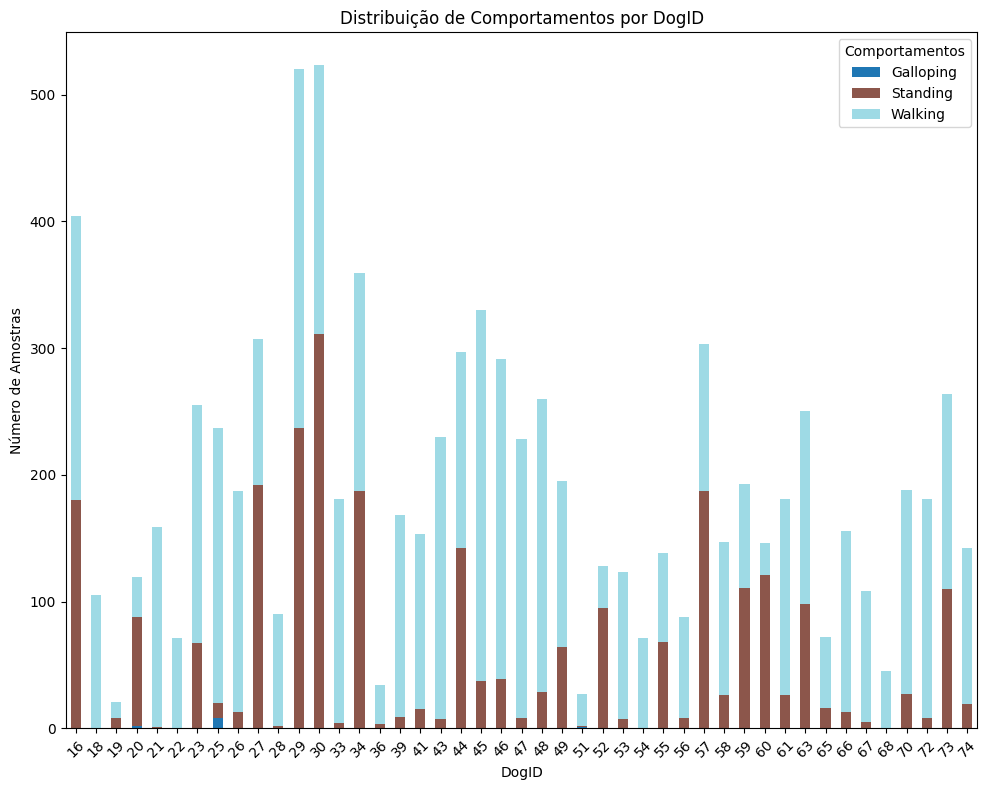

In [ ]:
class_distribution = df_.groupby(['DogID', 'Predominant_Behavior']).size().unstack(fill_value=0)
fig, ax = plt.subplots(figsize=(10, 8))
class_distribution.plot(kind='bar', stacked=True, ax=ax, colormap="tab20")
plt.title("Distribuição de Comportamentos por DogID")
plt.xlabel("DogID")
plt.ylabel("Número de Amostras")
plt.legend(title="Comportamentos")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Conforme o gráfico acima, as melhores distribuições e quantidade de dados está no **dogID 29 e 30**

### **Frequência das Amostras dos Comportamentos**
Mostra a frequência dos comportamentos predominantes no conjunto de dados filtrado.

In [ ]:
fig = px.histogram(
    df_,
    x='Predominant_Behavior',
    title='Frequência das Amostras dos Comportamentos',
    nbins=3,
    labels={'Predominant_Behavior': 'Behavior', 'count': 'Quantidade'})
fig.update_traces(texttemplate='%{y}', textposition='outside')
fig.update_layout(
    yaxis_range=[0, 15000],
    xaxis_title="Comportamento",
    yaxis_title="Quantidade",
    height=400,
    width=600)
fig.show()

### **Treinando a Árvore de Decisão**
Avalia o desempenho do classificador de árvore de decisão em prever comportamentos de cães, utilizando **validação cruzada leave-one-out**. Ele mede as métricas **F1 e recall** para cada cão, armazena os resultados em um DataFrame e identifica o melhor modelo com base na média do F1 Score.

In [ ]:
df_['Behavior_Code'] = LabelEncoder().fit_transform(df_['Predominant_Behavior'].values)

dog_ids = df_['DogID'].unique()
model_performance = []
best_model = None
best_f1_score = -np.inf

for dog_id in dog_ids:
    dog_data = df_[df_['DogID'] == dog_id].copy()
    X_dog = dog_data[['Aneck_Peak', 'Aneck_Energy', 'Aneck_CrossMean', 'Gneck_Peak', 'Gneck_Energy', 'Gneck_CrossMean']]
    y_dog = dog_data['Behavior_Code']

    loo = LeaveOneOut()
    f1_scores_dog = []
    recall_scores_dog = []

    for train_index, test_index in loo.split(X_dog):
        X_train, X_test = X_dog.iloc[train_index], X_dog.iloc[test_index]
        y_train, y_test = y_dog.iloc[train_index], y_dog.iloc[test_index]

        clf = DecisionTreeClassifier(max_depth=5)
        clf.fit(X_train, y_train)

        y_pred = clf.predict(X_test)
        f1_metric = f1_score(y_test, y_pred, average='macro')
        recall_metric = recall_score(y_test, y_pred, average='macro', zero_division=1)

        f1_scores_dog.append(f1_metric)
        recall_scores_dog.append(recall_metric)

    mean_f1_score = np.mean(f1_scores_dog)
    mean_recall_score = np.mean(recall_scores_dog)

    model_performance.append({
        'DogID': dog_id,
        'Model': clf,
        'F1_Score': mean_f1_score,
        'Recall': mean_recall_score,
    })

    # Atualizar o melhor modelo
    if mean_f1_score > best_f1_score:
        best_f1_score = mean_f1_score
        best_model = clf

df_model_performance = pd.DataFrame(model_performance)
print(df_model_performance)

<ipython-input-34-9cff4ac346c5>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



    DogID                                Model  F1_Score    Recall
0      16  DecisionTreeClassifier(max_depth=5)  0.995050  0.997525
1      18  DecisionTreeClassifier(max_depth=5)  1.000000  1.000000
2      19  DecisionTreeClassifier(max_depth=5)  0.809524  0.904762
3      20  DecisionTreeClassifier(max_depth=5)  0.974790  0.987395
4      21  DecisionTreeClassifier(max_depth=5)  0.993711  0.996855
5      22  DecisionTreeClassifier(max_depth=5)  1.000000  1.000000
6      23  DecisionTreeClassifier(max_depth=5)  0.968627  0.984314
7      25  DecisionTreeClassifier(max_depth=5)  0.957806  0.978903
8      26  DecisionTreeClassifier(max_depth=5)  0.967914  0.983957
9      27  DecisionTreeClassifier(max_depth=5)  1.000000  1.000000
10     28  DecisionTreeClassifier(max_depth=5)  1.000000  1.000000
11     29  DecisionTreeClassifier(max_depth=5)  0.976923  0.988462
12     30  DecisionTreeClassifier(max_depth=5)  0.986616  0.993308
13     33  DecisionTreeClassifier(max_depth=5)  0.994475  0.99

### Avaliação dos modelos

#### **F1 Score e Recall**
Gráfico com subplots para visualizar a distribuição do F1 Score e do Recall obtidos a partir do modelo de classificação.

In [ ]:
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        "Distribuição do F1", "Histograma dos F1",
        "Distribuição do Recall", "Histograma dos Recall"
    ))

# Box Plot para F1 Score
fig.add_trace(go.Box(
    y=df_model_performance['F1_Score'],
    boxpoints='all',
    jitter=0.3,
    pointpos=-1.8,
    marker_color='blue',
    fillcolor='blue',
    showlegend=False
), row=1, col=1)

# Histograma para F1 Score
fig.add_trace(go.Histogram(
    x=df_model_performance['F1_Score'],
    nbinsx=10,
    marker=dict(line=dict(color='black', width=1)),
    opacity=0.7,
    showlegend=False
), row=1, col=2)

# Box Plot para Recall
fig.add_trace(go.Box(
    y=df_model_performance['Recall'],
    boxpoints='all',
    jitter=0.3,
    pointpos=-1.8,
    marker_color='green',
    fillcolor='green',
    showlegend=False
), row=2, col=1)

# Histograma para Recall
fig.add_trace(go.Histogram(
    x=df_model_performance['Recall'],
    nbinsx=10,
    marker=dict(line=dict(color='black', width=1)),
    opacity=0.7,
    showlegend=False
), row=2, col=2)

# Atualizar layout da figura
fig.update_layout(
    title_text="Distribuição dos Score F1 e Recall do Classificador por DogID",
    height=800,
    width=1500
)

fig.update_yaxes(title_text="Score F1", row=1, col=1)
fig.update_xaxes(title_text="Decision Tree", showticklabels=False, row=1, col=1)
fig.update_xaxes(title_text="Score F1", row=1, col=2)
fig.update_yaxes(title_text="Frequência", row=1, col=2)
fig.update_yaxes(title_text="Score Recall", row=2, col=1)
fig.update_xaxes(title_text="Decision Tree", showticklabels=False, row=2, col=1)
fig.update_xaxes(title_text="Score Recall", row=2, col=2)
fig.update_yaxes(title_text="Frequência", row=2, col=2)
fig.show()

#### **F1 Score por Modelo Treinado**
Visualizar a distribuição do F1 Score de diferentes modelos treinados.

In [ ]:
df_model_performance['Model_Order'] = range(1, len(df_model_performance) + 1)

fig = px.bar(
    df_model_performance,
    x='Model_Order',
    y='F1_Score',
    title='Distribuição do F1 Score por Modelo Treinado',
    labels={'Model_Order': 'Ordem do Modelo', 'Mean_F1_Score': 'Escore F1 Médio'},
    text='DogID')
fig.update_traces(texttemplate='DogID %{text}', textposition='inside')
fig.update_layout(
    xaxis_title='Modelos treinados',
    yaxis_title='Escore F1',
    height=500,
    width=1600,
    bargap=0.1)
fig.show()

**O modelo selecionado como o melhor para avaliação foi escolhido com base em dois critérios principais:**
  - Distribuição balanceada da base de dados utilizada para o seu treinamento
  - Maximização das métricas de desempenho (F1-score e o recall)
  
A distribuição equilibrada dos dados é fundamental para garantir que o modelo tenha sido exposto a uma diversidade representativa de padrões, evitando vieses e melhorando sua capacidade de generalização. Além disso, foco em maximizar tanto o F1-score quanto o recall assegura que o modelo tenha um bom equilíbrio entre precisão e cobertura. Considerando esses fatores, o modelo de índice 30 foi selecionado como o mais robusto e confiável para a etapa de avaliação final.

### **Árvore de Decisão do Melhor Modelo**

In [ ]:
best_model = df_model_performance['Model'][12] # modelo de índice 30
b_modelID = df_model_performance['DogID'][12]

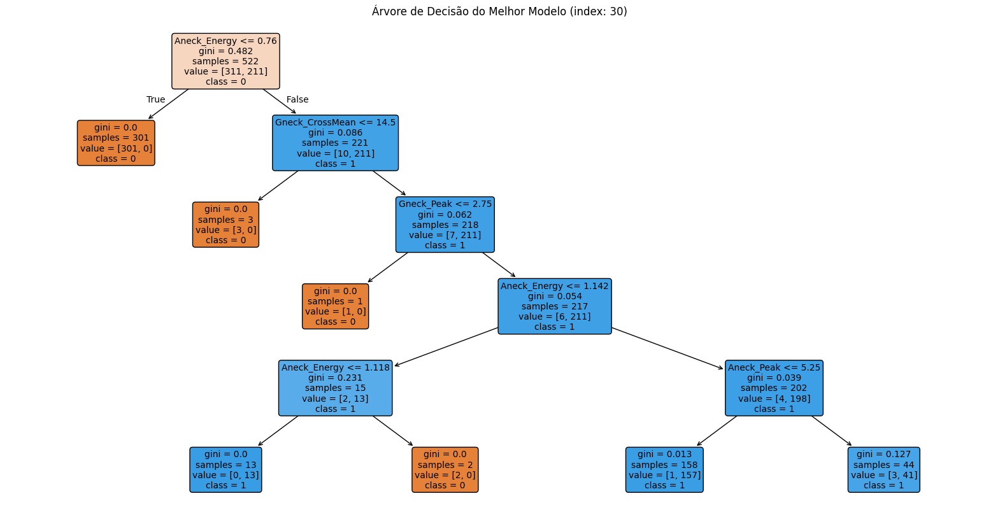

In [ ]:
plt.figure(figsize=(20, 10))
plot_tree(best_model,
  feature_names=['Aneck_Peak', 'Aneck_Energy', 'Aneck_CrossMean', 'Gneck_Peak', 'Gneck_Energy', 'Gneck_CrossMean'],
  class_names=[str(cls) for cls in set(df_['Behavior_Code'])],
  filled=True,
  rounded=True,
  fontsize=10)
plt.title(f"Árvore de Decisão do Melhor Modelo (index: {b_modelID})")
plt.show()


### **Matriz de Confusão**
Análise de desempenho do modelo de classificação em relação a um conjunto de dados de um cão específico. Filtra os dados para o cão desejado, gera previsões usando o melhor modelo treinado, e apresenta uma matriz de confusão visualmente interpretável que compara as previsões com as classes reais.

In [ ]:
dog_data = df_[df_['DogID'] == b_modelID].copy()
X_dog = dog_data[['Aneck_Peak', 'Aneck_Energy', 'Aneck_CrossMean', 'Gneck_Peak', 'Gneck_Energy', 'Gneck_CrossMean']]
y_dog = dog_data['Behavior_Code']


y_pred = best_model.predict(X_dog)
labels = np.unique(y_dog)
conf_matrix = confusion_matrix(y_dog, y_pred, labels=labels)

fig = ff.create_annotated_heatmap(
    z=conf_matrix,
    x=labels.tolist(),
    y=labels.tolist(),
    colorscale="Viridis",
    showscale=True)
fig.update_layout(
    title=f"Matriz de Confusão do Melhor Modelo (index: {b_modelID})",
    xaxis_title="Valores Preditos",
    yaxis_title="Valores Reais")
fig.show()

O modelo teve um desempenho muito bom em prever as classes, com uma baixa quantidade de erros de classificação. A maior parte das predições está concentrada na diagonal principal da matriz, o que indica uma alta precisão nas predições do modelo. Há uma pequena quantidade de confusões entre as classes, principalmente no caso das classes 1 e 2, onde algumas instâncias foram preditas incorretamente, mas o impacto é mínimo no resultado geral.

### **Conclusão do desempenho do classificador**

As métricas **F1 Score e Recall** reforçam o desempenho sólido do modelo. O F1 Score, que é de **0,9866**, sugere que o modelo consegue manter um bom equilíbrio entre precisão e sensibilidade. Isso significa que ele tem uma alta taxa de acertos e consegue identificar corretamente as diferentes classes sem muita variação. O Recall, com um valor de **0,9933**, indica que o modelo possui uma excelente cobertura para as classes, minimizando o número de falsos negativos. Essas métricas sugerem um modelo altamente confiável e eficiente.

Com base na análise da matriz de confusão e nas métricas de F1 Score e Recall, podemos concluir que **o classificador demonstra um desempenho excelente**. Ele consegue diferenciar bem entre as classes, mantendo um alto nível de precisão e sensibilidade.